# Descriptive Analysis

This file contains the descriptive analysis of the given dataset (Chicago 2018). We will analyze temporal and geographical demand patterns, as well as defining Key Performance Indicators (KPIs)

To get started and get all of the required dataset, open the projects README.md for links and project setup, after that this notebooks contains the following sections:

1. Data Loading
2. Temporal Demand and Seasonality
3. Geographical Demand
4. Key Performance Indicators

In [2]:
# General Imports for the whole file
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import timedelta
from datetime import datetime
from pandas.plotting import register_matplotlib_converters
import folium
from folium import plugins
from folium.plugins import HeatMap
import math
import random
import timeit

import warnings
warnings.filterwarnings('ignore')

# 1. Data Loading
Load the given dataset into pandas

In [3]:
bike_df = pd.read_csv('data/chicago_2018.csv')
weather = pd.read_csv('data/weather_hourly_chicago.csv')

# change datatype from string to datetime
bike_df['start_time'] = pd.to_datetime(bike_df['start_time'])
bike_df['end_time'] = pd.to_datetime(bike_df['end_time'])

In [39]:
# add useful inferrable data
bike_df['date'] = bike_df['start_time'].dt.date
bike_df['hour'] = bike_df['start_time'].dt.hour
bike_df['weekday'] = bike_df['start_time'].dt.weekday
bike_df['month'] = bike_df['start_time'].dt.month
bike_df['duration'] = bike_df['end_time'] - bike_df['start_time']

### Data Integrity

Check for missing or malformed data in the dataset

In [4]:
# how many entries are there, where start_time occurs later than end_time?
bike_df[bike_df['start_time'] > bike_df['end_time']].shape[0]

7

In [5]:
# only consider entries where start_time comes before end_time
bike_df = bike_df[bike_df['start_time'] < bike_df['end_time']]

In [6]:
# there are several very short rentals where start and end are identical --> possible erroneous rentals?!
filter1 = bike_df['start_station_id'] == bike_df['end_station_id']
filter2 = bike_df['duration'] < timedelta(seconds=120)

In [7]:
# number of those rentals
bike_df[np.logical_and(filter1, filter2)].shape[0]

7790

In [8]:
# remove those rows
# bike_df = bike_df[np.logical_not(np.logical_and(filter1, filter2))]

# 2. Temporal Demand and Seasonality

In the following, we will demonstrate how fleet usage varies during a day, a week and the year

## 2.1 Hourly Demand

In [9]:
bike_df.head()

,start_time,end_time,start_station_id,end_station_id,start_station_name,end_station_name,bike_id,user_type,date,hour,weekday,month,duration
0,2018-04-01 00:04:44,2018-04-01 00:13:03,22,171,May St & Taylor St,May St & Cullerton St,3819,Subscriber,2018-04-01,0,6,4,0 days 00:08:19
1,2018-04-01 00:06:42,2018-04-01 00:27:07,157,190,Lake Shore Dr & Wellington Ave,Southport Ave & Wrightwood Ave,5000,Subscriber,2018-04-01,0,6,4,0 days 00:20:25
2,2018-04-01 00:07:19,2018-04-01 00:23:19,106,106,State St & Pearson St,State St & Pearson St,5165,Customer,2018-04-01,0,6,4,0 days 00:16:00
3,2018-04-01 00:07:33,2018-04-01 00:14:47,241,171,Morgan St & Polk St,May St & Cullerton St,3851,Subscriber,2018-04-01,0,6,4,0 days 00:07:14
4,2018-04-01 00:10:23,2018-04-01 00:22:12,228,219,Damen Ave & Melrose Ave,Damen Ave & Cortland St,5065,Subscriber,2018-04-01,0,6,4,0 days 00:11:49


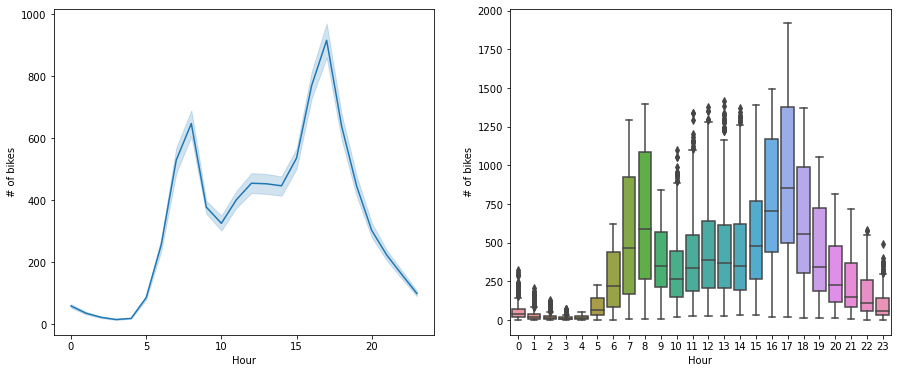

In [10]:
# hourly demand
bike_hourly_demand = bike_df.groupby(['date', 'hour'])['bike_id'].nunique()
bike_hourly_demand = pd.DataFrame(bike_hourly_demand)

fig, ax = plt.subplots(1,2, figsize=(15,6))

sns.lineplot(x=bike_hourly_demand.index.get_level_values(1), y=bike_hourly_demand['bike_id'],ax=ax[0])

sns.boxplot(x=bike_hourly_demand.index.get_level_values(1), y=bike_hourly_demand['bike_id'],ax=ax[1])

ax[0].set(xlabel='Hour', ylabel='# of bikes')
ax[1].set(xlabel='Hour', ylabel='# of bikes')
plt.show()

These two plots show the daily demand of bikes. As we can see, the demand spikes twice, once at 8 am and the second time at 5 pm. These times are often referred to as rush hours, which makes sense, since there are a lot of people using the bikes to get to work and back home. This can be especially demonstrated as we are looking at the following four plots, which show the daily demand of bikes separated by customers and subscribers.

### Hourly Demand by Usertype

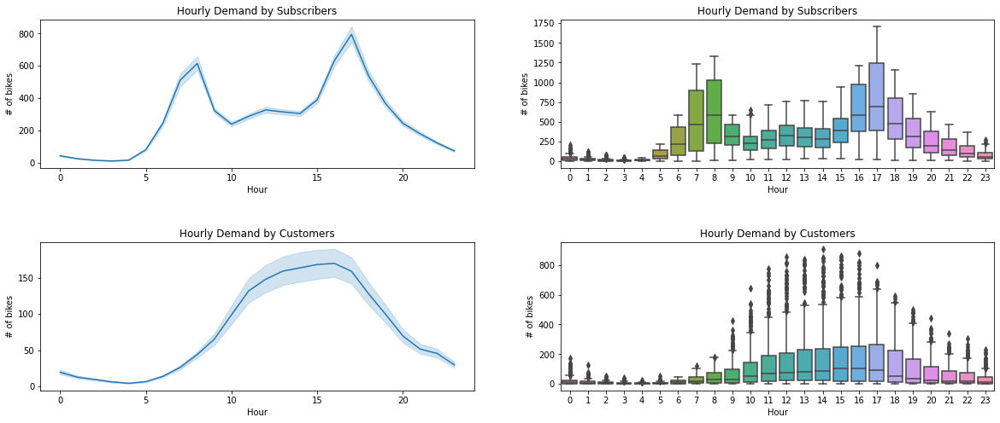

In [11]:
# hourly demand by usertype
bike_hourly_demand_subscriber = bike_df[bike_df['user_type'] == 'Subscriber'].groupby(['date', 'hour'])['bike_id'].nunique()
bike_hourly_demand_subscriber = pd.DataFrame(bike_hourly_demand_subscriber)

bike_hourly_demand_customer = bike_df[bike_df['user_type'] == 'Customer'].groupby(['date', 'hour'])['bike_id'].nunique()
bike_hourly_demand_customer = pd.DataFrame(bike_hourly_demand_customer)

fig, ax = plt.subplots(2,2, figsize=(20,8))

sns.lineplot(x=bike_hourly_demand_subscriber.index.get_level_values(1), y=bike_hourly_demand_subscriber['bike_id'],ax=ax[0,0])

sns.boxplot(x=bike_hourly_demand_subscriber.index.get_level_values(1), y=bike_hourly_demand_subscriber['bike_id'],ax=ax[0,1])

sns.lineplot(x=bike_hourly_demand_customer.index.get_level_values(1), y=bike_hourly_demand_customer['bike_id'],ax=ax[1,0])

sns.boxplot(x=bike_hourly_demand_customer.index.get_level_values(1), y=bike_hourly_demand_customer['bike_id'],ax=ax[1,1])

ax[0,0].set(xlabel='Hour', ylabel='# of bikes')
ax[0,1].set(xlabel='Hour', ylabel='# of bikes')
ax[1,0].set(xlabel='Hour', ylabel='# of bikes')
ax[1,1].set(xlabel='Hour', ylabel='# of bikes')

fig.subplots_adjust(hspace=.5)

ax[0,0].set_title('Hourly Demand by Subscribers')
ax[0,1].set_title('Hourly Demand by Subscribers')
ax[1,0].set_title('Hourly Demand by Customers')
ax[1,1].set_title('Hourly Demand by Customers')

plt.show()

Here we observe, that the second peak of the daily demand of subscribers in is not that high compared to the second peak of the daily demand of all users. This is, because the customers have a generally higher use between 11 am and 7 pm.

## 2.2 Daily Demand

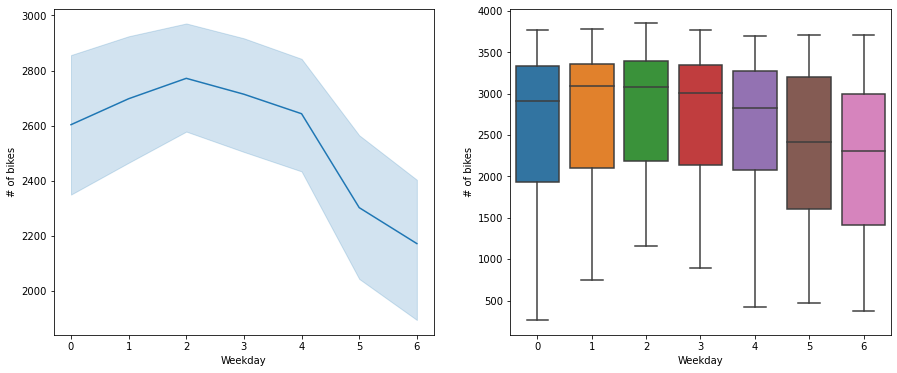

In [12]:
# daily demand
bike_daily_demand = bike_df.groupby(['date', 'weekday'])['bike_id'].nunique()
bike_daily_demand = pd.DataFrame(bike_daily_demand)

fig, ax = plt.subplots(1,2, figsize=(15,6))

sns.lineplot(x=bike_daily_demand.index.get_level_values(1), y=bike_daily_demand['bike_id'],ax=ax[0])

sns.boxplot(x=bike_daily_demand.index.get_level_values(1), y=bike_daily_demand['bike_id'],ax=ax[1])

ax[0].set(xlabel='Weekday', ylabel='# of bikes')
ax[1].set(xlabel='Weekday', ylabel='# of bikes')
plt.show()

The second time frame we are looking at is the demand dependent on the day of the week. The boxplots do not show it that well, but looking at the line plot, we can see, that the demand is lower on the weekend, which again lets us think, that maybe a big part of the users use the bikes to get to work, which usually does not happen on the weekend. We can go further into this by looking at the demand dependent on the weekday, separated again by customers and subscribers.

### Daily Demand by usertype

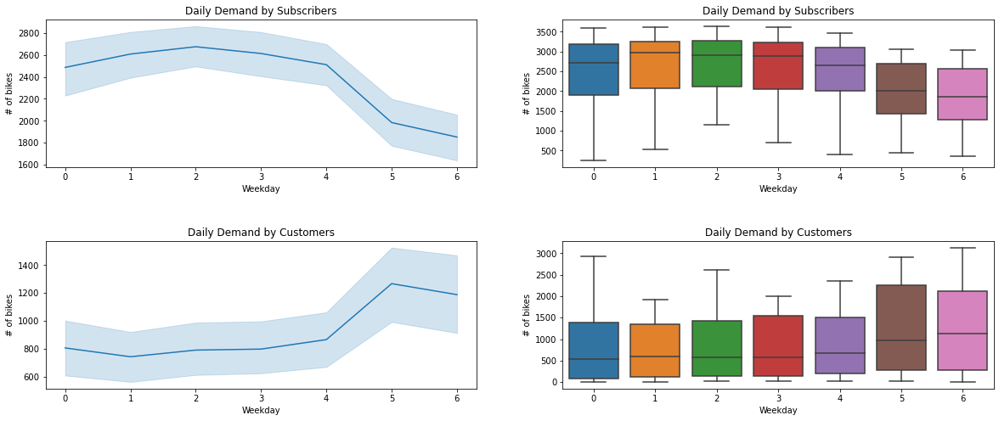

In [13]:
# daily demand by usertype
bike_daily_demand_subscriber = bike_df[bike_df['user_type'] == 'Subscriber'].groupby(['date', 'weekday'])['bike_id'].nunique()
bike_daily_demand_subscriber = pd.DataFrame(bike_daily_demand_subscriber)

bike_daily_demand_customer = bike_df[bike_df['user_type'] == 'Customer'].groupby(['date', 'weekday'])['bike_id'].nunique()
bike_daily_demand_customer = pd.DataFrame(bike_daily_demand_customer)

fig, ax = plt.subplots(2,2, figsize=(20,8))

sns.lineplot(x=bike_daily_demand_subscriber.index.get_level_values(1), y=bike_daily_demand_subscriber['bike_id'],ax=ax[0,0])

sns.boxplot(x=bike_daily_demand_subscriber.index.get_level_values(1), y=bike_daily_demand_subscriber['bike_id'],ax=ax[0,1])

sns.lineplot(x=bike_daily_demand_customer.index.get_level_values(1), y=bike_daily_demand_customer['bike_id'],ax=ax[1,0])

sns.boxplot(x=bike_daily_demand_customer.index.get_level_values(1), y=bike_daily_demand_customer['bike_id'],ax=ax[1,1])

ax[0,0].set(xlabel='Weekday', ylabel='# of bikes')
ax[0,1].set(xlabel='Weekday', ylabel='# of bikes')
ax[1,0].set(xlabel='Weekday', ylabel='# of bikes')
ax[1,1].set(xlabel='Weekday', ylabel='# of bikes')

fig.subplots_adjust(hspace=.5)

ax[0,0].set_title('Daily Demand by Subscribers')
ax[0,1].set_title('Daily Demand by Subscribers')
ax[1,0].set_title('Daily Demand by Customers')
ax[1,1].set_title('Daily Demand by Customers')

plt.show()

These plots demonstrate, that subscribers rather not use the bikes on the weekend, where customers especially like to use them.

## 2.3 Monthly Demand

In [14]:
# monthly demand
bike_monthly_demand = bike_df.groupby(['date', 'month'])['bike_id'].nunique()
bike_monthly_demand = pd.DataFrame(bike_monthly_demand)

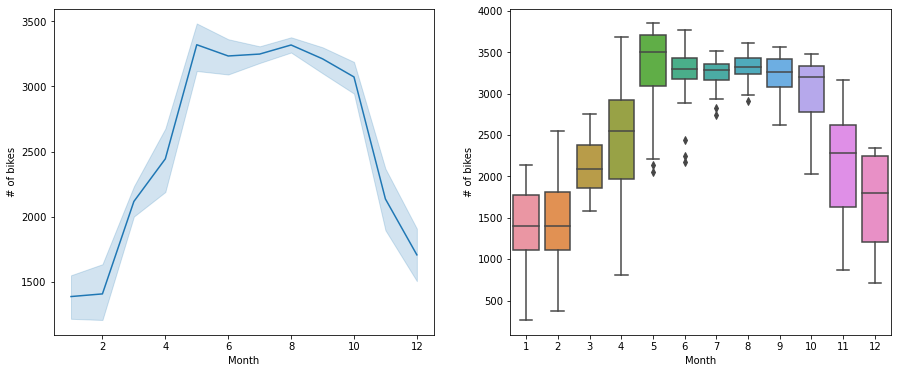

In [15]:
fig, ax = plt.subplots(1,2, figsize=(15,6))

sns.lineplot(x=bike_monthly_demand.index.get_level_values(1), y=bike_monthly_demand['bike_id'],ax=ax[0])

sns.boxplot(x=bike_monthly_demand.index.get_level_values(1), y=bike_monthly_demand['bike_id'],ax=ax[1])

ax[0].set(xlabel='Month', ylabel='# of bikes')
ax[1].set(xlabel='Month', ylabel='# of bikes')
plt.show()

Lastly we have a look at how the demand varies over the course of a year. The monthly demand show is increasing during the first five months, until it peaks on a pretty much constant value for five months until October, where it decreases until the end of the year. And again we can separate those values into subscribers and customers.

### Monthly Demand by usertype

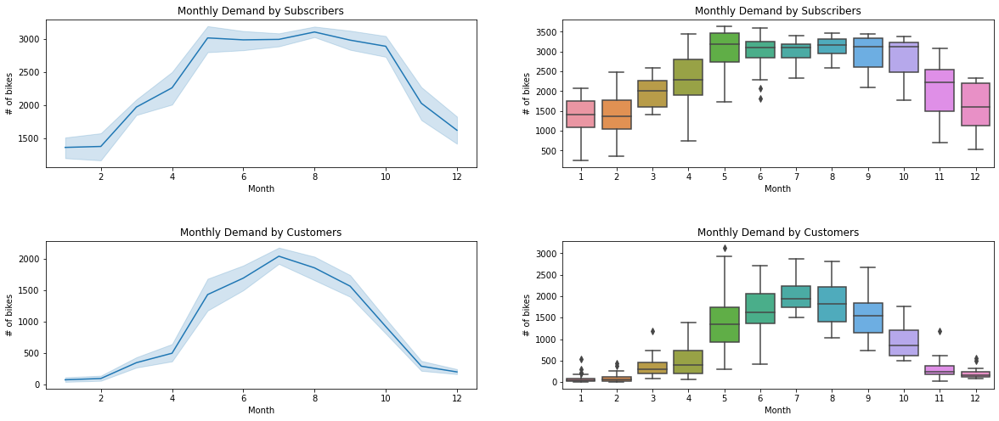

In [16]:
# monthly demand by usertype
bike_monthly_demand_subscriber = bike_df[bike_df['user_type'] == 'Subscriber'].groupby(['date', 'month'])['bike_id'].nunique()
bike_monthly_demand_subscriber = pd.DataFrame(bike_monthly_demand_subscriber)

bike_monthy_demand_customer = bike_df[bike_df['user_type'] == 'Customer'].groupby(['date', 'month'])['bike_id'].nunique()
bike_monthy_demand_customer = pd.DataFrame(bike_monthy_demand_customer)


fig, ax = plt.subplots(2,2, figsize=(20,8))

sns.lineplot(x=bike_monthly_demand_subscriber.index.get_level_values(1), y=bike_monthly_demand_subscriber['bike_id'],ax=ax[0,0])

sns.boxplot(x=bike_monthly_demand_subscriber.index.get_level_values(1), y=bike_monthly_demand_subscriber['bike_id'],ax=ax[0,1])

sns.lineplot(x=bike_monthy_demand_customer.index.get_level_values(1), y=bike_monthy_demand_customer['bike_id'],ax=ax[1,0])

sns.boxplot(x=bike_monthy_demand_customer.index.get_level_values(1), y=bike_monthy_demand_customer['bike_id'],ax=ax[1,1])

ax[0,0].set(xlabel='Month', ylabel='# of bikes')
ax[0,1].set(xlabel='Month', ylabel='# of bikes')
ax[1,0].set(xlabel='Month', ylabel='# of bikes')
ax[1,1].set(xlabel='Month', ylabel='# of bikes')

fig.subplots_adjust(hspace=.5)

ax[0,0].set_title('Monthly Demand by Subscribers')
ax[0,1].set_title('Monthly Demand by Subscribers')
ax[1,0].set_title('Monthly Demand by Customers')
ax[1,1].set_title('Monthly Demand by Customers')

plt.show()

Separating them shows that all users do not like driving in the colder months. While the subscribers are looking to use the bikes earlier and later in the year, which makes sense, because they are paying for it no matter the weather, the customers peak specifically in July. Before that their demand increases and after that their demand decreases again. That could be caused by that they only pay per ride, so as long as they decide to take an option that is in their opinion at least the better option taking the weather into consideration, they will opt for the better option.

Take aways:
- demand during the day is highest between 6-9 and 15-19
- demand during the week is higher on working days than on the weekend
- demand during the year is higher in summer than in winter

# 3. Geographical Demand

Next up we will investigate the recognisable geographical patterns in the dataset 

Now I am interested into how many observations there are within the dataset.

In [17]:
bike_df.count()

start_time            3603075
end_time              3603075
start_station_id      3603075
end_station_id        3603075
start_station_name    3603075
end_station_name      3603075
bike_id               3603075
user_type             3603075
date                  3603075
hour                  3603075
weekday               3603075
month                 3603075
duration              3603075
dtype: int64

How many *start* and *end* stations are there?

In [18]:
start_stations = list(bike_df["start_station_id"].unique())
end_stations = list(bike_df["end_station_id"].unique())
print("There are", len(start_stations), "start stations, and", len(end_stations), "end stations")

There are 621 start stations, and 619 end stations


Thus there are 2 more start stations than end stations. This might be because there are stations,
* in which you can only rent a bike; not return
* which have multiple IDs
* which are only for maintenance purposes

Or because
* start station IDs and end station IDs are completely uncoupled and one of the reasons above

I was wondering how big the fleet is:

In [19]:
def getTime(str):
    return datetime.strptime(str, '%Y-%m-%d %H:%M:%S')

In [20]:
num_bikes = len(list(bike_df["bike_id"].unique()))

print("The fleet consists of", num_bikes, "bikes.")

The fleet consists of 6133 bikes.


What is the ratio of subscribed users as compared to all users in 2018?

In [21]:
num_subs = len(bike_df[bike_df["user_type"] == "Subscriber"])
num_tot = len(bike_df)

print(round((num_subs / num_tot * 100), 2), "% of users are actual subscribers")

81.21 % of users are actual subscribers


Check for null values.

Which stations are used the most?

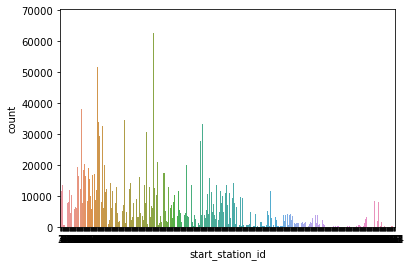

In [22]:
sns.countplot(x = "start_station_id", data = bike_df)
plt.show()

Which station is used the most?

In [23]:
station_mostused = bike_df["start_station_id"].value_counts().idxmax()
print("The most used start station is the station with id", station_mostused)

The most used start station is the station with id 35


## An attempt to visualize the most used stations geographically

First I import a dataset that I found on the [internet](https://data.cityofchicago.org/Transportation/Divvy-Bicycle-Stations-In-Service/67g3-8ig8) to describe the position (long, lat) of the stations.

In [55]:
data_stations = pd.read_csv("data/Divvy_Bicycle_Stations_-_In_Service.csv")

In [56]:
data_stations.head(10)

,ID,Station Name,Total Docks,Docks in Service,Status,Latitude,Longitude,Location
0,373,Kedzie Ave & Chicago Ave,11,11,In Service,41.895465,-87.706128,"(41.89546530305, -87.7061278837)"
1,641,Central Park Ave & Bloomingdale Ave,11,11,In Service,41.914166,-87.716755,"(41.914166, -87.716755)"
2,102,Stony Island Ave & 67th St,11,11,In Service,41.773458,-87.585340,"(41.77345849948, -87.5853397391)"
3,438,Central Park Ave & Ogden Ave,15,15,In Service,41.854064,-87.715117,"(41.854063503874464, -87.71511733531952)"
4,656,Damen Ave & Walnut (Lake) St,15,15,In Service,41.885951,-87.677009,"(41.885951, -87.677009)"
5,691,Eggleston Ave & 92nd St,15,15,In Service,41.727576,-87.634828,"(41.727575659299575, -87.63482809066771)"
6,648,Carpenter St & 63rd St,7,7,In Service,41.779870,-87.650919,"(41.77987, -87.650919)"
7,418,Ellis Ave & 53rd St,11,11,In Service,41.799336,-87.600958,"(41.79933626261, -87.6009581145)"
8,649,Stewart Ave & 63rd St,11,11,In Service,41.779835,-87.634774,"(41.779835, -87.634774)"
9,658,Leavitt St & Division St,15,15,In Service,41.902997,-87.683825,"(41.902997, -87.683825)"


Joining (merging) the initial dataset with the dataset, which contains the coordinates for the stations on the column 'start_station_id', respectively 'ID'

In [26]:
merged_data = pd.merge(bike_df, data_stations, left_on = "start_station_id", right_on = "ID")

In [27]:
merged_data.head(3)

,start_time,end_time,start_station_id,end_station_id,start_station_name,end_station_name,bike_id,user_type,date,hour,...,month,duration,ID,Station Name,Total Docks,Docks in Service,Status,Latitude,Longitude,Location
0,2018-04-01 00:04:44,2018-04-01 00:13:03,22,171,May St & Taylor St,May St & Cullerton St,3819,Subscriber,2018-04-01,0,...,4,0 days 00:08:19,22,May St & Taylor St,15,15,In Service,41.869482,-87.655486,"(41.8694821, -87.6554864)"
1,2018-04-01 11:21:46,2018-04-01 11:30:46,22,103,May St & Taylor St,Clinton St & Polk St (*),595,Subscriber,2018-04-01,11,...,4,0 days 00:09:00,22,May St & Taylor St,15,15,In Service,41.869482,-87.655486,"(41.8694821, -87.6554864)"
2,2018-04-01 11:40:54,2018-04-01 11:47:45,22,342,May St & Taylor St,Wolcott Ave & Polk St,6457,Subscriber,2018-04-01,11,...,4,0 days 00:06:51,22,May St & Taylor St,15,15,In Service,41.869482,-87.655486,"(41.8694821, -87.6554864)"


Adding a new column "Coordinates" because the location, lat' and long' variables cannot be simply plotted by folium.

In [28]:
merged_data["Coordinates"] = list(zip(merged_data["Latitude"].round(4), merged_data["Longitude"].round(4)))

In [29]:
merged_data.head(3)

,start_time,end_time,start_station_id,end_station_id,start_station_name,end_station_name,bike_id,user_type,date,hour,...,duration,ID,Station Name,Total Docks,Docks in Service,Status,Latitude,Longitude,Location,Coordinates
0,2018-04-01 00:04:44,2018-04-01 00:13:03,22,171,May St & Taylor St,May St & Cullerton St,3819,Subscriber,2018-04-01,0,...,0 days 00:08:19,22,May St & Taylor St,15,15,In Service,41.869482,-87.655486,"(41.8694821, -87.6554864)","(41.8695, -87.6555)"
1,2018-04-01 11:21:46,2018-04-01 11:30:46,22,103,May St & Taylor St,Clinton St & Polk St (*),595,Subscriber,2018-04-01,11,...,0 days 00:09:00,22,May St & Taylor St,15,15,In Service,41.869482,-87.655486,"(41.8694821, -87.6554864)","(41.8695, -87.6555)"
2,2018-04-01 11:40:54,2018-04-01 11:47:45,22,342,May St & Taylor St,Wolcott Ave & Polk St,6457,Subscriber,2018-04-01,11,...,0 days 00:06:51,22,May St & Taylor St,15,15,In Service,41.869482,-87.655486,"(41.8694821, -87.6554864)","(41.8695, -87.6555)"


In [30]:
sns.set()
sns.set_style("white")
sns.set_palette("GnBu_d")

# First visualization attempts

I will select a random bike for showing the locations to avoid overplotting and to avoid performance issues

In [31]:
list_bikes = bike_df["bike_id"].unique()
random_bike = random.choice(list_bikes)
print(random_bike)

1804


In [32]:
heat_map = folium.Map(location=(41.8695, -87.6555), tiles='OpenStreetMap', zoom_start=9, control_scale=True, max_zoom=20)

heat_map.add_child(plugins.HeatMap(merged_data[merged_data["bike_id"] == random_bike]["Coordinates"], radius = 15))

heat_map

Slicing the dataframe in order to be able to assign the correct popup to the markers

In [33]:
station_location = merged_data[['start_station_id', 'Latitude', 'Longitude']].copy()
station_location = station_location.drop_duplicates(subset = ["start_station_id"])
station_location.head(10)

,start_station_id,Latitude,Longitude
0,22,41.869482,-87.655486
9437,157,41.936688,-87.636829
20677,106,41.897448,-87.628722
32618,241,41.871737,-87.651030
47115,228,41.940600,-87.678500
49933,244,41.954690,-87.673930
54430,128,41.895769,-87.677220
64277,130,41.903266,-87.678435
71049,121,41.802562,-87.590368
74245,31,41.896747,-87.635668


In [34]:
heat_map = folium.Map(location=(41.8695, -87.6555), tiles='OpenStreetMap', zoom_start=9, control_scale=True, max_zoom=20)

heat_map.add_child(plugins.HeatMap(merged_data[merged_data["bike_id"] == random_bike]["Coordinates"], radius = 15))

for indice, row in station_location.iterrows():
    folium.CircleMarker(
        radius = 1,
        location=[row["Latitude"], row["Longitude"]],
        popup=row['start_station_id'],
        color='crimson', 
        fill_color='crimson'
    ).add_to(heat_map)
  
heat_map

Plotting the density of used bikestations for bikes with an id lower than 1000 (because plotting this for all bikes would just not terminate)

In [35]:
heat_map = folium.Map(location=(41.8695, -87.6555), tiles='OpenStreetMap', zoom_start=9, control_scale=True, max_zoom=20)

heat_map.add_child(plugins.HeatMap(merged_data[merged_data["bike_id"] < 1000]["Coordinates"], radius = 15))

heat_map

Adding a column 'end_hour' to the dataframe, in order to be able to easily access only the hour from the 'end_time' timestamp

In [36]:
merged_data['end_time'] = pd.to_datetime(merged_data['end_time'])
merged_data["end_hour"] = list(merged_data["end_time"].dt.hour)
merged_data.head()

,start_time,end_time,start_station_id,end_station_id,start_station_name,end_station_name,bike_id,user_type,date,hour,...,ID,Station Name,Total Docks,Docks in Service,Status,Latitude,Longitude,Location,Coordinates,end_hour
0,2018-04-01 00:04:44,2018-04-01 00:13:03,22,171,May St & Taylor St,May St & Cullerton St,3819,Subscriber,2018-04-01,0,...,22,May St & Taylor St,15,15,In Service,41.869482,-87.655486,"(41.8694821, -87.6554864)","(41.8695, -87.6555)",0
1,2018-04-01 11:21:46,2018-04-01 11:30:46,22,103,May St & Taylor St,Clinton St & Polk St (*),595,Subscriber,2018-04-01,11,...,22,May St & Taylor St,15,15,In Service,41.869482,-87.655486,"(41.8694821, -87.6554864)","(41.8695, -87.6555)",11
2,2018-04-01 11:40:54,2018-04-01 11:47:45,22,342,May St & Taylor St,Wolcott Ave & Polk St,6457,Subscriber,2018-04-01,11,...,22,May St & Taylor St,15,15,In Service,41.869482,-87.655486,"(41.8694821, -87.6554864)","(41.8695, -87.6555)",11
3,2018-04-01 15:22:44,2018-04-01 15:40:08,22,47,May St & Taylor St,State St & Kinzie St,5797,Subscriber,2018-04-01,15,...,22,May St & Taylor St,15,15,In Service,41.869482,-87.655486,"(41.8694821, -87.6554864)","(41.8695, -87.6555)",15
4,2018-04-01 15:22:44,2018-04-01 15:40:08,22,47,May St & Taylor St,State St & Kinzie St,2295,Subscriber,2018-04-01,15,...,22,May St & Taylor St,15,15,In Service,41.869482,-87.655486,"(41.8694821, -87.6554864)","(41.8695, -87.6555)",15


Now taking all rows with an end time between 6am and 10am and assigning it to a new dataframe 

In [37]:
morning_stations = merged_data[(merged_data["end_hour"]<=9) & (merged_data["end_hour"] >= 6)]
morning_stations.head()

,start_time,end_time,start_station_id,end_station_id,start_station_name,end_station_name,bike_id,user_type,date,hour,...,ID,Station Name,Total Docks,Docks in Service,Status,Latitude,Longitude,Location,Coordinates,end_hour
8,2018-04-02 08:10:35,2018-04-02 08:15:39,22,317,May St & Taylor St,Wood St & Taylor St,4179,Subscriber,2018-04-02,8,...,22,May St & Taylor St,15,15,In Service,41.869482,-87.655486,"(41.8694821, -87.6554864)","(41.8695, -87.6555)",8
26,2018-04-03 08:01:24,2018-04-03 08:08:29,22,317,May St & Taylor St,Wood St & Taylor St,2632,Subscriber,2018-04-03,8,...,22,May St & Taylor St,15,15,In Service,41.869482,-87.655486,"(41.8694821, -87.6554864)","(41.8695, -87.6555)",8
27,2018-04-03 09:28:51,2018-04-03 09:37:44,22,414,May St & Taylor St,Canal St & Taylor St,3375,Subscriber,2018-04-03,9,...,22,May St & Taylor St,15,15,In Service,41.869482,-87.655486,"(41.8694821, -87.6554864)","(41.8695, -87.6555)",9
36,2018-04-04 07:58:13,2018-04-04 08:22:05,22,111,May St & Taylor St,Sedgwick St & Huron St,864,Subscriber,2018-04-04,7,...,22,May St & Taylor St,15,15,In Service,41.869482,-87.655486,"(41.8694821, -87.6554864)","(41.8695, -87.6555)",8
37,2018-04-04 08:05:52,2018-04-04 08:13:58,22,317,May St & Taylor St,Wood St & Taylor St,4132,Subscriber,2018-04-04,8,...,22,May St & Taylor St,15,15,In Service,41.869482,-87.655486,"(41.8694821, -87.6554864)","(41.8695, -87.6555)",8


Now taking all rows with an end time between 4pm and 7pm and assigning it to a new dataframe 

In [38]:
evening_stations = merged_data[(merged_data["end_hour"]<=18) & (merged_data["end_hour"] >= 16)]
evening_stations.head()

,start_time,end_time,start_station_id,end_station_id,start_station_name,end_station_name,bike_id,user_type,date,hour,...,ID,Station Name,Total Docks,Docks in Service,Status,Latitude,Longitude,Location,Coordinates,end_hour
6,2018-04-01 18:23:51,2018-04-01 18:26:44,22,241,May St & Taylor St,Morgan St & Polk St,4913,Subscriber,2018-04-01,18,...,22,May St & Taylor St,15,15,In Service,41.869482,-87.655486,"(41.8694821, -87.6554864)","(41.8695, -87.6555)",18
15,2018-04-02 16:45:36,2018-04-02 17:03:34,22,287,May St & Taylor St,Franklin St & Monroe St,3851,Subscriber,2018-04-02,16,...,22,May St & Taylor St,15,15,In Service,41.869482,-87.655486,"(41.8694821, -87.6554864)","(41.8695, -87.6555)",17
16,2018-04-02 16:45:36,2018-04-02 17:03:38,22,287,May St & Taylor St,Franklin St & Monroe St,1642,Subscriber,2018-04-02,16,...,22,May St & Taylor St,15,15,In Service,41.869482,-87.655486,"(41.8694821, -87.6554864)","(41.8695, -87.6555)",17
17,2018-04-02 16:52:24,2018-04-02 16:56:50,22,137,May St & Taylor St,Morgan Ave & 14th Pl,4438,Subscriber,2018-04-02,16,...,22,May St & Taylor St,15,15,In Service,41.869482,-87.655486,"(41.8694821, -87.6554864)","(41.8695, -87.6555)",16
33,2018-04-03 16:15:42,2018-04-03 16:31:12,22,33,May St & Taylor St,State St & Van Buren St,2708,Subscriber,2018-04-03,16,...,22,May St & Taylor St,15,15,In Service,41.869482,-87.655486,"(41.8694821, -87.6554864)","(41.8695, -87.6555)",16


Now we are able to **map all the stations, where people frequently drive to in the morning hours**. These stations will probably be in close proximity to common workplaces

In [39]:
heat_map = folium.Map(location=(41.8695, -87.6555), tiles='OpenStreetMap', zoom_start=9, control_scale=True, max_zoom=20)

heat_map.add_child(plugins.HeatMap(morning_stations[morning_stations["bike_id"]==random_bike]["Coordinates"], radius = 15))

for indice, row in station_location.iterrows():
    folium.CircleMarker(
        radius = 1,
        location=[row["Latitude"], row["Longitude"]],
        popup=row['start_station_id'],
        color='crimson', 
        fill_color='crimson'
    ).add_to(heat_map)

heat_map

It seems that there is a clear aggregation of trips to the **central station** in the **morning hours**

Now we do the same for the **evening hours** , i.e. the end stations people drive to after work

In [40]:
heat_map = folium.Map(location=(41.8695, -87.6555), tiles='OpenStreetMap', zoom_start=9, control_scale=True, max_zoom=20)

heat_map.add_child(plugins.HeatMap(evening_stations[evening_stations["bike_id"]==random_bike]["Coordinates"], radius = 15))

for indice, row in station_location.iterrows():
    folium.CircleMarker(
        radius = 1,
        location=[row["Latitude"], row["Longitude"]],
        popup=row['start_station_id'],
        color='crimson', 
        fill_color='crimson'
    ).add_to(heat_map)

heat_map

Now it is harder to identify a clear direction to where trips are typically going

We now try to identify the movement of the selected bike. We therefore draw the stations and trajectories.

In [41]:
heat_map = folium.Map(location=(41.8695, -87.6555), tiles='OpenStreetMap', zoom_start=9, control_scale=True, max_zoom=20)

merged_data_select = merged_data[merged_data["bike_id"]==random_bike]

heat_map.add_child(plugins.HeatMap(merged_data[merged_data["bike_id"] == random_bike]["Coordinates"], radius = 15))

for indice, row in station_location.iterrows():
    folium.CircleMarker(
        radius = 1,
        location=[row["Latitude"], row["Longitude"]],
        popup=row['start_station_id'],
        color='crimson', 
        fill_color='crimson'
    ).add_to(heat_map)

folium.PolyLine(merged_data_select["Coordinates"],color="blue", weight=2, opacity=0.8, ).add_to(heat_map)
    
heat_map

# Geographical Findings

## Locations / POI with most traffic

In some zoom-scales (and the given radius) one can identify the following highly used stations:

* [Ogilvie Transportation Center](https://en.wikipedia.org/wiki/Ogilvie_Transportation_Center)
* [Chicago Union Station](https://en.wikipedia.org/wiki/Chicago_Union_Station)
* Jane Addams Memorial, see [googlemaps](https://www.google.de/maps/place/Divvy/@41.8922479,-87.6121172,88m/data=!3m1!1e3!4m13!1m7!3m6!1s0x880e2c3cd0f4cbed:0xafe0a6ad09c0c000!2sChicago,+IL,+USA!3b1!8m2!3d41.8781136!4d-87.6297982!3m4!1s0x880e2b53a71cd513:0xd04bc26796dcb054!8m2!3d41.892278!4d-87.612043) for position


## City Districts

The geographical data of the city districts can be found here [Link](https://data.cityofchicago.org/Facilities-Geographic-Boundaries/Boundaries-Community-Areas-current-/cauq-8yn6), where you can export the dataset as a geojson-file.https://data.cityofchicago.org/Facilities-Geographic-Boundaries/Boundaries-Community-Areas-current-/cauq-8yn6

In [78]:
import json

In [81]:
distr_geo = json.load(open("data/Boundaries - Community Areas (current).geojson"))

In [84]:
from shapely.geometry import Point
from shapely.geometry.polygon import Polygon

In [85]:
dist_dict = {}

for feature in distr_geo['features']:
    a = feature['properties']['community']
    ls = feature['geometry']['coordinates']
    dist_dict[a] = Polygon(ls[0][0])

In [86]:
p = Point(-87.6555, 41.8695)
p.within(dist_dict["NEAR WEST SIDE"])

True

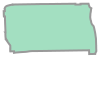

In [87]:
dist_dict["NEAR WEST SIDE"]

In [89]:
def getDist(p):
    for key in dist_dict:
        if dist_dict[key].contains(p):
            return key

In [90]:
getDist(p)

'NEAR WEST SIDE'

In [91]:
def getStartDist(long, lat):
    po = Point(long, lat)
    return getDist(po)

In [92]:
b = []

for row, index in merged_data.iterrows():
    long = index["Longitude"]
    lat = index["Latitude"]
    b.append(getStartDist(long, lat))

In [94]:
dist_count_dict = {}

districts = pd.DataFrame(b)[0].unique()

for i in districts:
    dist_count_dict[i] = b.count(i)


In [96]:
count = pd.DataFrame.from_dict(dist_count_dict, orient='index')
count.reset_index(inplace = True)
count.sort_values(inplace = True, by = 0, ascending = False)
count.rename(columns = {0: 'Rentals in 2018', 'index': 'Community Area'}, inplace = True)

In [98]:
fig, ax = plt.subplots(2,1,dpi = 800, figsize = (16, 13))
sns.barplot(ax = ax[0], data = count.head(7), y = "Rentals in 2018", x = "Community Area", palette = "viridis_r")
ax[0].set_title("Most Popular 7 Community Areas")
ax[1].set_title("Least Popular 7 Community Areas")
sns.barplot(ax = ax[1], data = count.tail(7).sort_values("Rentals in 2018"), y = "Rentals in 2018", x = "Community Area", palette = "rocket")

plt.show()

In [100]:
m = folium.Map(tiles = "CartoDB positron", location=(41.8695, -87.6555), width=1000,height=1000,)

# You can switch between a scale from the quantiles of the usage to a linear scale be commenting one of
# the lines below!

#bins = list(count["Rentals in 2018"].quantile([0, 0.25, 0.5, 0.75, 1]))
bins = np.linspace(count["Rentals in 2018"].min(), count["Rentals in 2018"].max(), 5)
            
folium.Choropleth(
    geo_data=distr_geo,
    name="choropleth",
    data=count,
    columns=["Community Area", "Rentals in 2018"],
    key_on="feature.properties.community",
    fill_color="BuPu", # 'BuGn', 'BuPu', 'GnBu', 'OrRd', 'PuBu', 'PuBuGn', 'PuRd', 'RdPu','YlGn', 'YlGnBu', 'YlOrBr', and 'YlOrRd'.
    fill_opacity=0.6,
    line_opacity=0.2,
    bins=bins,
    legend_name="Rides",
).add_to(m)

folium.LayerControl().add_to(m)

m

## Attempt to take POI into consideration

The list of POI was found on [Wikipedia](https://en.wikipedia.org/wiki/List_of_Chicago_Landmarks) and can be downloaded under this [Link](https://tools.wmflabs.org/kmlexport?article=List_of_Chicago_Landmarks).

For pandas to handle the data properly the file must be converted into csv format. Therefore the converted file can be found (together with the repo) under data/poi.csv

In [42]:
POI_data = pd.read_csv("data/poi.csv")

In [43]:
POI_data.head()

,name,lat,long
0,300 West Adams Building,-87.635833,41.879722
1,333 North Michigan Building,-87.624167,41.887778
2,35 East Wacker Building,-87.626667,41.886389
3,42nd Precinct / Town Hall Police Stationg,-87.650000,41.947500
4,63rd Street Bathing Pavilion,-87.573889,41.781389


In [44]:
POI_data.head()

,name,lat,long
0,300 West Adams Building,-87.635833,41.879722
1,333 North Michigan Building,-87.624167,41.887778
2,35 East Wacker Building,-87.626667,41.886389
3,42nd Precinct / Town Hall Police Stationg,-87.650000,41.947500
4,63rd Street Bathing Pavilion,-87.573889,41.781389


In [45]:
POI_data["Coordinates"] = list(zip(POI_data["long"].round(4), POI_data["lat"].round(4)))

In [46]:
POI_data.count()

name           191
lat            191
long           191
Coordinates    191
dtype: int64

In [47]:
POI_data.head()

,name,lat,long,Coordinates
0,300 West Adams Building,-87.635833,41.879722,"(41.8797, -87.6358)"
1,333 North Michigan Building,-87.624167,41.887778,"(41.8878, -87.6242)"
2,35 East Wacker Building,-87.626667,41.886389,"(41.8864, -87.6267)"
3,42nd Precinct / Town Hall Police Stationg,-87.650000,41.947500,"(41.9475, -87.65)"
4,63rd Street Bathing Pavilion,-87.573889,41.781389,"(41.7814, -87.5739)"


In [48]:
heat_map = folium.Map(location=(41.8695, -87.6555), tiles='OpenStreetMap', zoom_start=9, control_scale=True, max_zoom=20)

heat_map.add_child(plugins.HeatMap(merged_data[merged_data["bike_id"] < 1000]["Coordinates"], radius = 15))

positions = list(POI_data["Coordinates"])
for position in positions:
    folium.CircleMarker(radius=1, location=position, popup='The Waterfront', 
                                 color='crimson', fill_color='crimson').add_to(heat_map)

heat_map

It seems that those POI's correspond nicely to the density of used stations.

## Finding out which stations are most popular

In [49]:
data_stations.head()

,ID,Station Name,Total Docks,Docks in Service,Status,Latitude,Longitude,Location
0,373,Kedzie Ave & Chicago Ave,11,11,In Service,41.895465,-87.706128,"(41.89546530305, -87.7061278837)"
1,641,Central Park Ave & Bloomingdale Ave,11,11,In Service,41.914166,-87.716755,"(41.914166, -87.716755)"
2,102,Stony Island Ave & 67th St,11,11,In Service,41.773458,-87.585340,"(41.77345849948, -87.5853397391)"
3,438,Central Park Ave & Ogden Ave,15,15,In Service,41.854064,-87.715117,"(41.854063503874464, -87.71511733531952)"
4,656,Damen Ave & Walnut (Lake) St,15,15,In Service,41.885951,-87.677009,"(41.885951, -87.677009)"


In [50]:
data_stations.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 690 entries, 0 to 689
Data columns (total 8 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   ID                690 non-null    int64  
 1   Station Name      690 non-null    object 
 2   Total Docks       690 non-null    int64  
 3   Docks in Service  690 non-null    int64  
 4   Status            690 non-null    object 
 5   Latitude          690 non-null    float64
 6   Longitude         690 non-null    float64
 7   Location          690 non-null    object 
dtypes: float64(2), int64(3), object(3)
memory usage: 43.2+ KB


In [51]:
data_stations.loc[2, "ID"]

102

In [52]:
for i in range(690):
    data_stations.loc[i, "Usage"] = len(merged_data[merged_data["start_station_id"] == data_stations.loc[i, "ID"]])

In [53]:
data_stations["Coordinates"] = list(zip(data_stations["Latitude"].round(4), data_stations["Longitude"].round(4)))

In [54]:
data_stations.head()

,ID,Station Name,Total Docks,Docks in Service,Status,Latitude,Longitude,Location,Usage,Coordinates
0,373,Kedzie Ave & Chicago Ave,11,11,In Service,41.895465,-87.706128,"(41.89546530305, -87.7061278837)",634.0,"(41.8955, -87.7061)"
1,641,Central Park Ave & Bloomingdale Ave,11,11,In Service,41.914166,-87.716755,"(41.914166, -87.716755)",175.0,"(41.9142, -87.7168)"
2,102,Stony Island Ave & 67th St,11,11,In Service,41.773458,-87.585340,"(41.77345849948, -87.5853397391)",314.0,"(41.7735, -87.5853)"
3,438,Central Park Ave & Ogden Ave,15,15,In Service,41.854064,-87.715117,"(41.854063503874464, -87.71511733531952)",246.0,"(41.8541, -87.7151)"
4,656,Damen Ave & Walnut (Lake) St,15,15,In Service,41.885951,-87.677009,"(41.885951, -87.677009)",117.0,"(41.886, -87.677)"


In [55]:
data_stations["Usage"].describe()

count      690.000000
mean      5167.388406
std       7749.148547
min          0.000000
25%        150.000000
50%       1981.500000
75%       7605.750000
max      66944.000000
Name: Usage, dtype: float64

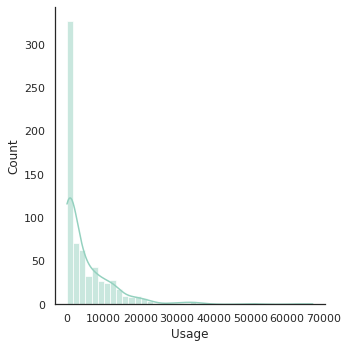

In [56]:
sns.displot(data = data_stations["Usage"] , kde=True)

plt.show()

As expected a poisson-like distribution with a wide base of rather unpopular stations and a tiny share of extremely popular stations.

In [57]:
len(bike_df["start_station_id"].unique())

621

In the following I attempt to plot the tops (reddish) and flops (blue) of stations in terms of popularity on a map.

In [58]:
topTwy = data_stations[data_stations["ID"] <= 621].sort_values("Usage").tail(100)
lowTwy = data_stations[data_stations["ID"] <= 621].sort_values("Usage").head(100)

In [59]:
topTwy["Popular"] = "crimson"
lowTwy["Popular"] = "blue"

topLowTwy = [topTwy, lowTwy]
topLowTwy = pd.concat(topLowTwy)
topLowTwy

,ID,Station Name,Total Docks,Docks in Service,Status,Latitude,Longitude,Location,Usage,Coordinates,Popular
643,50,Clark St & Ida B Wells Dr,35,35,In Service,41.875933,-87.630585,"(41.8759326655, -87.6305845355)",11920.0,"(41.8759, -87.6306)",crimson
410,229,Southport Ave & Roscoe St,19,19,In Service,41.943739,-87.664020,"(41.943739, -87.66402)",11924.0,"(41.9437, -87.664)",crimson
148,144,Larrabee St & Webster Ave,19,19,In Service,41.921822,-87.644140,"(41.921822, -87.64414)",11928.0,"(41.9218, -87.6441)",crimson
240,106,State St & Pearson St,27,27,In Service,41.897448,-87.628722,"(41.897448, -87.628722)",11941.0,"(41.8974, -87.6287)",crimson
115,75,Canal St & Jackson Blvd,43,43,In Service,41.877245,-87.639366,"(41.877245, -87.639366)",11981.0,"(41.8772, -87.6394)",crimson
...,...,...,...,...,...,...,...,...,...,...,...
98,408,Union Ave & Root St,11,11,In Service,41.819102,-87.643278,"(41.819102, -87.643278)",363.0,"(41.8191, -87.6433)",blue
584,412,Princeton Ave & 47th St,11,11,In Service,41.809318,-87.633449,"(41.80931770924, -87.633449288)",366.0,"(41.8093, -87.6334)",blue
215,385,Princeton Ave & Garfield Blvd,11,11,In Service,41.794982,-87.633124,"(41.794982, -87.633124)",379.0,"(41.795, -87.6331)",blue
339,532,Austin Blvd & Lake St,11,11,In Service,41.887919,-87.774446,"(41.887919, -87.774446)",380.0,"(41.8879, -87.7744)",blue


In [60]:
heat_map = folium.Map(location=(41.8695, -87.6555), tiles='OpenStreetMap', zoom_start=9, control_scale=True, max_zoom=20)

for i in range(len(topLowTwy)):
    folium.CircleMarker(radius=1, location = topLowTwy.iloc[i]["Coordinates"], 
                                 color=topLowTwy.iloc[i]["Popular"], popup = topLowTwy.iloc[i]["ID"], fill_color='crimson').add_to(heat_map)

heat_map

As popular and unpopular stations nicely discriminate geographically, I'm interested as to how the entirety of stations would be ordered. 

In [61]:
data_stations = data_stations[data_stations["ID"] < 621].sort_values("Usage")

g1 = data_stations[data_stations["Usage"] < 1000]
g2 = data_stations[(data_stations["Usage"] >= 1000) & (data_stations["Usage"] < 10000)]
g3 = data_stations[data_stations["Usage"] >= 10000]
                   
g1["Color"] = "green"
g2["Color"] = "yellow"
g3["Color"] = "red"

stat = [g1, g2, g3]
stat = pd.concat(stat)
stat

,ID,Station Name,Total Docks,Docks in Service,Status,Latitude,Longitude,Location,Usage,Coordinates,Color
497,562,Racine Ave & 61st St,11,11,In Service,41.783189,-87.654372,"(41.783189, -87.654372)",8.0,"(41.7832, -87.6544)",green
199,556,Throop St & 52nd St,7,7,In Service,41.799659,-87.657195,"(41.799659, -87.657195)",13.0,"(41.7997, -87.6572)",green
106,537,Kenton Ave & Madison St,11,11,In Service,41.880708,-87.741018,"(41.880708, -87.741018)",14.0,"(41.8807, -87.741)",green
169,565,Ashland Ave & 66th St,7,7,In Service,41.774074,-87.663815,"(41.774074, -87.663815)",15.0,"(41.7741, -87.6638)",green
221,540,Laramie Ave & Madison St,11,11,In Service,41.880207,-87.755337,"(41.880207, -87.755337)",19.0,"(41.8802, -87.7553)",green
...,...,...,...,...,...,...,...,...,...,...,...
595,43,Michigan Ave & Washington St,43,43,In Service,41.883984,-87.624684,"(41.8839840647265, -87.6246839761734)",38029.0,"(41.884, -87.6247)",red
597,91,Clinton St & Washington Blvd,31,31,In Service,41.883380,-87.641170,"(41.88338, -87.64117)",48669.0,"(41.8834, -87.6412)",red
239,77,Clinton St & Madison St,31,31,In Service,41.882242,-87.641066,"(41.882242, -87.641066)",51692.0,"(41.8822, -87.6411)",red
354,192,Canal St & Adams St,47,47,In Service,41.879255,-87.639904,"(41.879255, -87.639904)",62654.0,"(41.8793, -87.6399)",red


In [62]:
heat_map = folium.Map(location=(41.8695, -87.6555), tiles='OpenStreetMap', zoom_start=9, control_scale=True, max_zoom=20)

for i in range(len(stat)):
    folium.CircleMarker(radius=2, location = stat.iloc[i]["Coordinates"], 
                                 color=stat.iloc[i]["Color"], fill_color='crimson',
                                   popup = stat.iloc[i]["Usage"]).add_to(heat_map)

heat_map

### Sights:

* University of Chicago (in an area of unpopular stations, you can easily find the station as it is a red marker in a bunch of yellow markers in the south)

In [63]:
bike_df[bike_df["start_station_id"] == 542].sort_values("start_time")

,start_time,end_time,start_station_id,end_station_id,start_station_name,end_station_name,bike_id,user_type,date,hour,weekday,month,duration
338328,2018-05-11 14:47:35,2018-05-11 15:49:39,542,542,Central Ave & Madison St,Central Ave & Madison St,3660,Subscriber,2018-05-11,14,4,5,0 days 01:02:04
421260,2018-05-19 16:50:32,2018-05-19 17:21:46,542,539,Central Ave & Madison St,Cicero Ave & Quincy St,6265,Customer,2018-05-19,16,5,5,0 days 00:31:14
421262,2018-05-19 16:50:47,2018-05-19 17:21:53,542,539,Central Ave & Madison St,Cicero Ave & Quincy St,4336,Customer,2018-05-19,16,5,5,0 days 00:31:06
462730,2018-05-23 20:46:32,2018-05-23 21:20:33,542,536,Central Ave & Madison St,Kostner Ave & Lake St,3899,Customer,2018-05-23,20,2,5,0 days 00:34:01
853472,2018-06-17 11:35:37,2018-06-17 11:41:17,542,544,Central Ave & Madison St,Austin Blvd & Madison St,3660,Subscriber,2018-06-17,11,6,6,0 days 00:05:40
939421,2018-06-23 18:38:22,2018-06-23 18:45:08,542,543,Central Ave & Madison St,Laramie Ave & Gladys Ave,5769,Subscriber,2018-06-23,18,5,6,0 days 00:06:46
1154309,2018-07-06 19:15:49,2018-07-07 05:52:34,542,529,Central Ave & Madison St,Cicero Ave & Lake St,5812,Customer,2018-07-06,19,4,7,0 days 10:36:45
1294871,2018-07-14 18:41:17,2018-07-14 19:20:01,542,88,Central Ave & Madison St,Racine Ave & Randolph St,4977,Customer,2018-07-14,18,5,7,0 days 00:38:44
1335994,2018-07-17 09:21:19,2018-07-17 10:12:14,542,161,Central Ave & Madison St,Rush St & Superior St,2311,Subscriber,2018-07-17,9,1,7,0 days 00:50:55
1493970,2018-07-26 10:32:43,2018-07-26 10:55:52,542,542,Central Ave & Madison St,Central Ave & Madison St,5092,Customer,2018-07-26,10,3,7,0 days 00:23:09


In [64]:
stat[stat["ID"] == 542]["Usage"]

312    29.0
Name: Usage, dtype: float64

### Finding out when new stations were established

In [65]:
bike_df[bike_df["start_station_id"] == 345]["start_time"].min()

Timestamp('2018-01-02 09:36:11')

In [66]:
def getFirstDate(ID):
    return bike_df[bike_df["start_station_id"] == ID]["start_time"].min()

In [67]:
data_stations["First Use"] = data_stations["ID"].apply(lambda x: getFirstDate(x))

In [68]:
data_stations.head()

,ID,Station Name,Total Docks,Docks in Service,Status,Latitude,Longitude,Location,Usage,Coordinates,First Use
497,562,Racine Ave & 61st St,11,11,In Service,41.783189,-87.654372,"(41.783189, -87.654372)",8.0,"(41.7832, -87.6544)",2018-03-18 14:50:33
199,556,Throop St & 52nd St,7,7,In Service,41.799659,-87.657195,"(41.799659, -87.657195)",13.0,"(41.7997, -87.6572)",2018-02-26 22:54:26
106,537,Kenton Ave & Madison St,11,11,In Service,41.880708,-87.741018,"(41.880708, -87.741018)",14.0,"(41.8807, -87.741)",2018-04-30 10:11:15
169,565,Ashland Ave & 66th St,7,7,In Service,41.774074,-87.663815,"(41.774074, -87.663815)",15.0,"(41.7741, -87.6638)",2018-06-25 16:20:59
221,540,Laramie Ave & Madison St,11,11,In Service,41.880207,-87.755337,"(41.880207, -87.755337)",19.0,"(41.8802, -87.7553)",2018-01-19 16:37:58


In [69]:
cutDate1 = pd.to_datetime("1st of February, 2018")
cutDate2 = pd.to_datetime("1st of May, 2018")

In [70]:
data_stations.iloc[34]["First Use"] < cutDate1

True

In [71]:
def categorize(x, a, b):
    if data_stations.iloc[x]["First Use"] < a:
        return "green"
    elif ((data_stations.iloc[x]["First Use"] >= a) & (data_stations.iloc[x]["First Use"] < b)):
        return "yellow"
    elif data_stations.iloc[x]["First Use"] > b:
        return "red"

In [72]:
cutDate1 > cutDate2

False

In [73]:
heat_map = folium.Map(location=(41.8695, -87.6555), tiles='OpenStreetMap', zoom_start=9, control_scale=True, max_zoom=20)

for i in range(len(data_stations)):
    folium.CircleMarker(radius=2, location = data_stations.iloc[i]["Coordinates"], 
                                 color=categorize(i, cutDate1, cutDate2), fill_color='crimson',
                                   popup = data_stations.iloc[i]["Usage"]).add_to(heat_map)

heat_map

As there is a substancial amount of unpopular stations (i.e. being used less than 100 times in a year, some even less than 30), I was wondering what reason there might be. The establishment of new stations seems like a plausible idea.

Thus I plotted all stations in a color that encodes the time of year in which the station was used first (in this period of a year).

* green: station was used in January for the first time
* yellow: station was used in February for the first time
* red: station was used only after the begin of March

With the red stations being low in number this hypothisis is to be rejected. Also it is possible that even those are old stations which just haven't been used in the cold season.

## Considering auto traffic

Again some data I found on the [internet](https://www.chicago.gov/city/en/depts/cdot/dataset/average_daily_trafficcounts.html)

### Average Daily Traffic

Average Daily Traffic refers to the number of vehicles traveling through a particular point on the city streets in a 24-hour period. Average Daily Traffic (ADT) counts are analogous to a census count of vehicles on city streets. These counts provide a close approximation to the actual number of vehicles passing through a given location on an average weekday.

In [74]:
traffic = pd.read_csv("data/Average_Daily_Traffic_Counts.csv", sep = ",")

In [75]:
traffic["Coordinates"] = list(zip(traffic["Latitude"].round(4), traffic["Longitude"].round(4)))

In [76]:
traffic.head()

,ID,Traffic Volume Count Location Address,Street,Date of Count,Total Passing Vehicle Volume,Vehicle Volume By Each Direction of Traffic,Latitude,Longitude,Location,Coordinates
0,414,5838 West,Lake St,11/14/2006,7100,East Bound: 3600 / West Bound: 3500,41.887904,-87.771064,"(41.887904, -87.771064)","(41.8879, -87.7711)"
1,176,320 East,76th St,03/28/2006,8600,East Bound: 3800 / West Bound: 4800,41.756542,-87.617335,"(41.756542, -87.617335)","(41.7565, -87.6173)"
2,1367,1730 East,57th Dr,08/24/2006,53500,East Bound: 27800 / West Bound: 25700,41.792663,-87.582231,"(41.792663, -87.582231)","(41.7927, -87.5822)"
3,316,125 East,24th St,03/30/2006,700,East Bound: 400 / West Bound: 300,41.849302,-87.622658,"(41.849302, -87.622658)","(41.8493, -87.6227)"
4,1294,2924 East,130th St,08/29/2006,4200,East Bound: 2300 / West Bound: 1900,41.659177,-87.552112,"(41.659177, -87.552112)","(41.6592, -87.5521)"


In [77]:
heat_map = folium.Map(location=(41.8695, -87.6555), tiles='OpenStreetMap', zoom_start=10, control_scale=True, max_zoom=20)

# heat_map.add_child(plugins.HeatMap(merged_data[merged_data["bike_id"] < 1000]["Coordinates"], radius = 25))

for i in range(0,len(traffic)):
   folium.Circle(
      location=[traffic.iloc[i]['Latitude'], traffic.iloc[i]['Longitude']],
      #popup=traffic.iloc[i]['Traffic Volume Count Location Address'],
      radius=float(traffic.iloc[i]['Total Passing Vehicle Volume'])*0.005,
      color='crimson',
      fill=True,
      fill_color='crimson'
   ).add_to(heat_map)

heat_map

# 4. Key Performance Indicators

In this section, we will make an attempt at defining Key Performance Indicators (KPIs) that are suitable to be included in a dashboard for bike sharing fleet operators, in this case the company "Divvy Bikes" from Chicago.

The KPIs that we will cover in the follwing are:
1. Share of Subscribers and Customers


## 4.1 Share of subscribers and customers

Nowadays, subscriptions are a common way to generate income and to retain customers, escpecially for services that may not be used daily. 
However, subscription models tread a thin line when it comes to pricing, since people are often quite temperate when it comes to additional monthly/annual expenses. 

In [101]:
bike_df['user_type'].value_counts()

Subscriber    2925920
Customer       677155
Name: user_type, dtype: int64

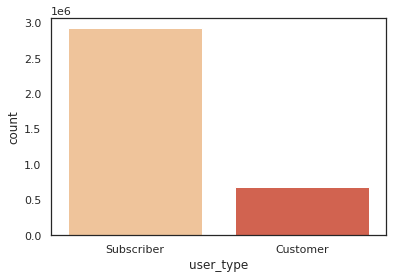

In [103]:
sns.countplot(x="user_type",data=bike_df, palette="OrRd")

plt.show()

In [111]:
bike_df.describe()

,start_station_id,end_station_id,bike_id,hour,weekday,month,duration
count,3.603075e+06,3.603075e+06,3.603075e+06,3.603075e+06,3.603075e+06,3.603075e+06,3603075
mean,1.894407e+02,1.901034e+02,3.483413e+03,1.371593e+01,2.820960e+00,7.008251e+00,0 days 00:23:33.145579539
std,1.405324e+02,1.404817e+02,1.934054e+03,4.723561e+00,1.929380e+00,2.607154e+00,0 days 09:59:04.890646931
min,2.000000e+00,2.000000e+00,1.000000e+00,0.000000e+00,0.000000e+00,1.000000e+00,0 days 00:01:01
25%,7.600000e+01,7.600000e+01,1.783000e+03,1.000000e+01,1.000000e+00,5.000000e+00,0 days 00:06:35
50%,1.650000e+02,1.660000e+02,3.599000e+03,1.500000e+01,3.000000e+00,7.000000e+00,0 days 00:11:13
75%,2.840000e+02,2.840000e+02,5.213000e+03,1.700000e+01,4.000000e+00,9.000000e+00,0 days 00:20:10
max,6.640000e+02,6.640000e+02,6.471000e+03,2.300000e+01,6.000000e+00,1.200000e+01,165 days 23:20:41


In [25]:
sub_cust_hourly = bike_df[["start_time", "bike_id", "user_type"]].groupby(["user_type", pd.Grouper(key="start_time", freq="H")]).count()

In [26]:
sub_cust_hourly

bike_id
user_type  start_time                  
Customer   2018-01-01 01:00:00        3
           2018-01-01 11:00:00        3
           2018-01-01 12:00:00        1
           2018-01-01 15:00:00        3
           2018-01-01 16:00:00        2
...                                 ...
Subscriber 2018-12-31 19:00:00       38
           2018-12-31 20:00:00       27
           2018-12-31 21:00:00       21
           2018-12-31 22:00:00       21
           2018-12-31 23:00:00       30

[16376 rows x 1 columns]

In [43]:
from ipywidgets import IntProgress
from IPython.display import display

def get_or_zero(index):
    if index in sub_cust_hourly.index:
        return sub_cust_hourly.loc[index]["bike_id"]
    else:
        return 0
    
f = IntProgress(min=0, max=24*365) # instantiate the bar
display(f) # display the bar

df = pd.DataFrame(columns=["time", "customer_share", "subscriber_share"])

for d in pd.date_range(start="1/1/2018", end="1/1/2019", freq="H"):
    f.value += 1
    num_cust = get_or_zero(("Customer", d))
    num_sub = get_or_zero(("Subscriber", d))
    
    if num_cust > 0 or num_sub > 0:
        df = df.append({"time": d, "customer_share": num_cust / (num_cust + num_sub), "subscriber_share": num_sub / (num_cust + num_sub)}, ignore_index=True)

IntProgress(value=0, max=8760)

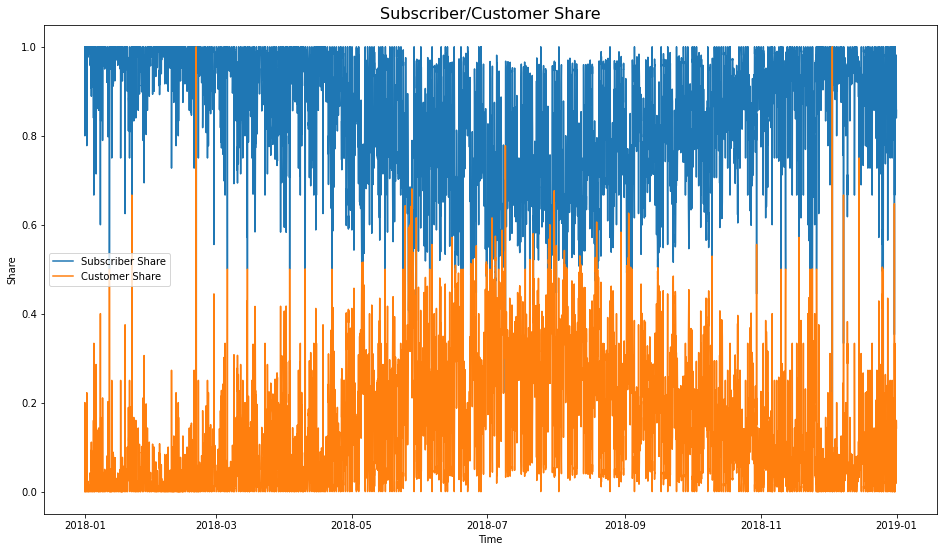

In [106]:
plt.figure(figsize=(16,9))

plt.plot(df["time"], df["subscriber_share"], label="Subscriber Share")
plt.plot(df["time"], df["customer_share"], label="Customer Share")

plt.xlabel('Time')
plt.ylabel('Share')
plt.title("Subscriber/Customer Share", fontsize=16)

plt.legend(loc=0)

plt.show()

## 4.2 Average Ride Duration 

The average ride duration and it's development can be a good indicator of how well the service is adopted and how satisfied the customers are. We also already have the derived column "duration" assigned above.

In [107]:
bike_df.duration.mean()

Timedelta('0 days 00:23:33.138314642')

In [108]:
tmp_set = bike_df[["start_time", "duration"]]
tmp_set["duration"] = tmp_set["duration"].astype('timedelta64[s]') 
durations = tmp_set.groupby(pd.Grouper(key="start_time", freq="H")).mean()    

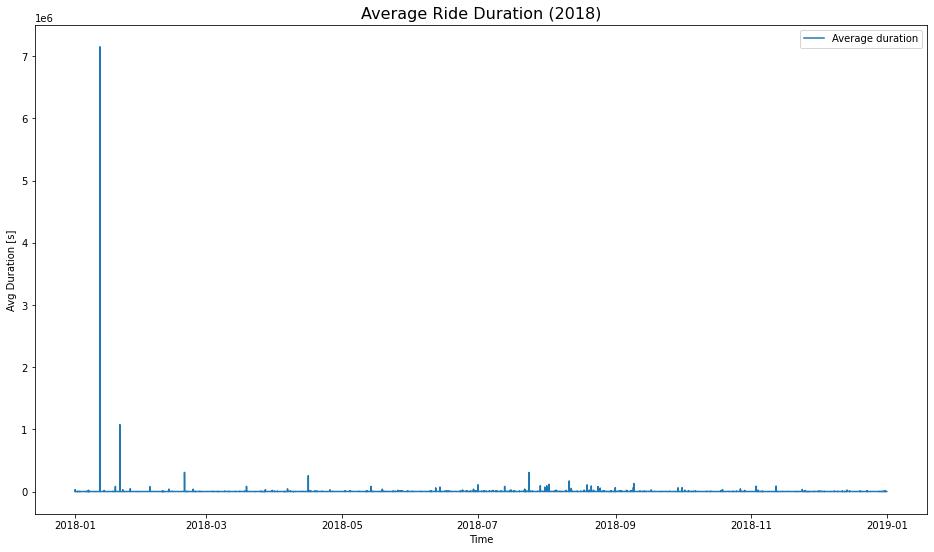

In [109]:
plt.figure(figsize=(16,9))

plt.plot(durations,label="Average duration")

plt.xlabel('Time')
plt.ylabel('Avg Duration [s]')
plt.title("Average Ride Duration (2018)", fontsize=16)

plt.legend(loc=0)

plt.show()

## 4.3 Departure and Arrival 

Does the sum of docking-stations correspond to the amount of bikes in the fleet?

In [53]:
print("Number of bikes in fleet:", len(bike_df["bike_id"].unique()))

Number of bikes in fleet: 6133


In [57]:
print("Number of docking-stations:", data_stations["Total Docks"].sum())

Number of docking-stations: 11463


Given that the amount of bikes is only two-thirds of the number of docking-stations, it seems reasonable to assume that there *could* be an equilibrium of correspondence for bike-to-stations at around this share.

In [69]:
def arrDepDiscrepancy(station_id, timeStart, duration):
    
    data_stationX = bike_df.loc[(bike_df["start_station_id"] == station_id) | (bike_df["end_station_id"] == station_id)]

    timeEnd = timeStart + timedelta(hours=duration)

    data_stationX_timeY = data_stationX.loc[(data_stationX["start_time"] >= timeStart) & (data_stationX["end_time"] < timeEnd)]

    arrivals = len(data_stationX_timeY.loc[data_stationX_timeY["end_station_id"] == station_id])
    departures = len(data_stationX_timeY.loc[data_stationX_timeY["start_station_id"] == station_id])
    
    return arrivals - departures


If we now compute the avg over all stations, we receive the System level arrival-departure discrepancy

In [77]:
from ipywidgets import IntProgress
from IPython.display import display
    
f = IntProgress(min=0, max=24*365) # instantiate the bar
display(f) # display the bar

stations = pd.concat([bike_df["end_station_id"], bike_df["start_station_id"]]).unique()
dis_df = pd.DataFrame(columns=["time", "dis"])

for d in pd.date_range(start="1/1/2018", end="1/1/2019", freq="H"):
    f.value += 1
    #dis = np.average([arrDepDiscrepancy(s, d, 1) for s in stations])
    dis = arrDepDiscrepancy(113, d, 1)
    dis_df = dis_df.append({"time": d, "dis": dis}, ignore_index=True)

IntProgress(value=0, max=8760)

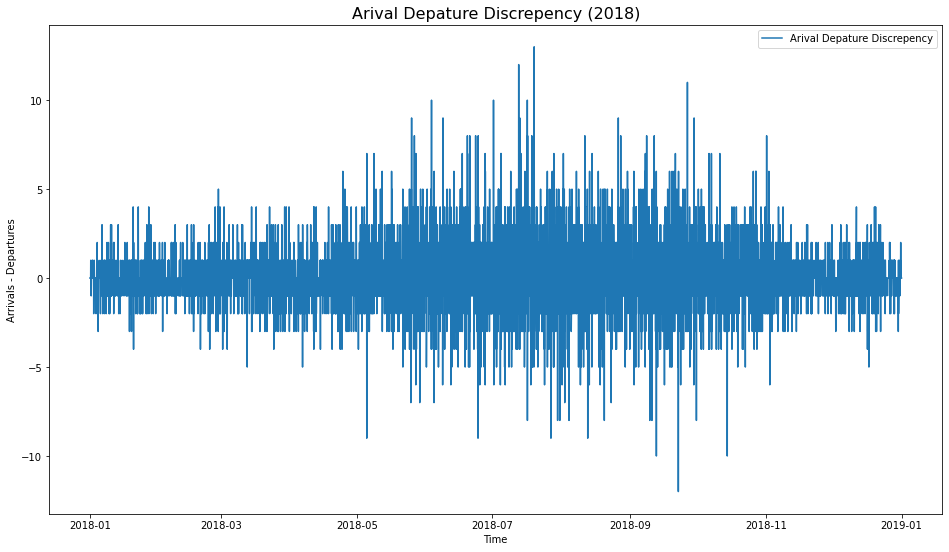

In [81]:
plt.figure(figsize=(16,9))

plt.plot(dis_df["time"], dis_df["dis"],label="Arival Depature Discrepency")

plt.xlabel('Time')
plt.ylabel('Arrivals - Departures')
plt.title("Arival Depature Discrepency (2018)", fontsize=16)

plt.legend(loc=0)

plt.show()

## 4.4 Single Ride Revenue

Since the given dataset only provides information about rides, one can not derive how how many subscribers divvybikes has in total.

The revenue of single rides though, can be analyzed. On the divvybikes [website](https://www.divvybikes.com/pricing/single-ride) one can find the information about pricing, which is

* \\$3.30 for the first 30 minutes of ride time, and
* \\$0.15/minute for each additional minute

*(Assuming pricing was the same in 2018)

In [95]:
def singleRideRevenue(x):
    if (x["user_type"] == "Subscriber"):
        return np.nan
    d = timedelta(minutes = 30)
    if (x["duration"] < d):
        return 3.3
    diff = x["duration"] - d
    return int((diff.total_seconds() / 60 ) + 1) * 0.15 + 3.3


In [97]:
revenue_set = bike_df[["start_time", "user_type", "duration"]]
revenue_set["price"] = revenue_set.apply(singleRideRevenue, axis=1)
revenue_set.dropna(inplace=True)

In [98]:
revenue_set

,start_time,user_type,duration,price
2,2018-04-01 00:07:19,Customer,0 days 00:16:00,3.30
17,2018-04-01 00:27:58,Customer,0 days 00:32:38,3.75
20,2018-04-01 00:38:15,Customer,0 days 00:06:02,3.30
25,2018-04-01 00:50:37,Customer,0 days 00:12:10,3.30
33,2018-04-01 01:12:35,Customer,0 days 00:12:37,3.30
...,...,...,...,...
3602979,2018-03-31 22:12:47,Customer,0 days 00:54:39,7.05
3602981,2018-03-31 22:12:53,Customer,0 days 00:54:21,7.05
3603027,2018-03-31 22:54:27,Customer,0 days 00:47:29,6.00
3603041,2018-03-31 23:06:05,Customer,0 days 00:17:15,3.30


In [99]:
revenue = revenue_set[["start_time", "price"]].groupby(pd.Grouper(key="start_time", freq="H")).sum()

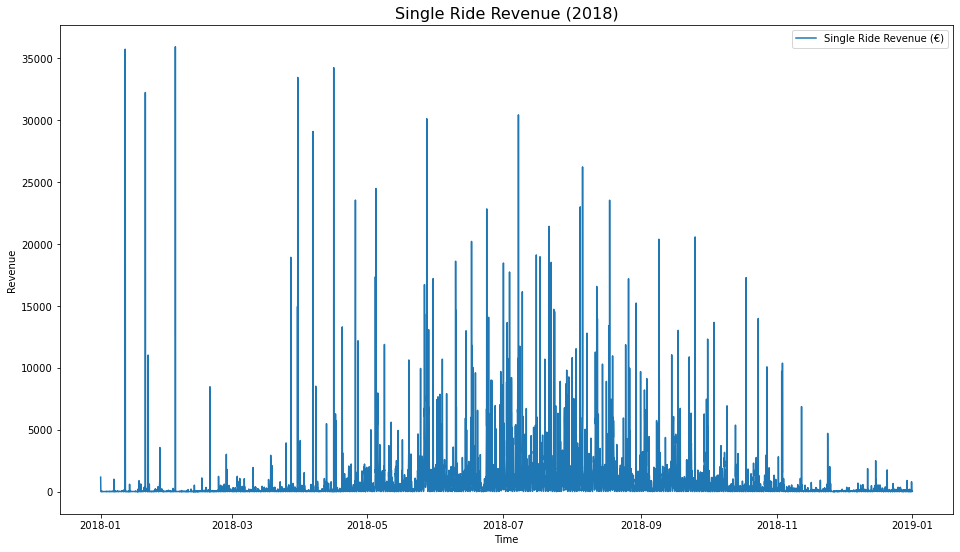

In [102]:
plt.figure(figsize=(16,9))

plt.plot(revenue.index, revenue["price"],label="Single Ride Revenue (€)")

plt.xlabel('Time')
plt.ylabel('Revenue')
plt.title("Single Ride Revenue (2018)", fontsize=16)

plt.legend(loc=0)

plt.show()